In [1]:
import pandas as pd
import zipfile
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import statsmodels.api as sm
from pylab import rcParams
from prophet import Prophet
from prophet.plot import plot_plotly, plot_components_plotly

In [2]:
zf = zipfile.ZipFile("archive.zip")
zf.namelist()

['Location1.csv',
 'Location2.csv',
 'Location3.csv',
 'Location4.csv',
 'readme.txt']

In [3]:
df_Loc_1 = pd.read_csv(zf.open('Location1.csv'))

In [4]:
df_Loc_1.dtypes

Time                    object
temperature_2m         float64
relativehumidity_2m      int64
dewpoint_2m            float64
windspeed_10m          float64
windspeed_100m         float64
winddirection_10m        int64
winddirection_100m       int64
windgusts_10m          float64
Power                  float64
dtype: object

In [5]:
df_Loc_1.tail(5)

,Time,temperature_2m,relativehumidity_2m,dewpoint_2m,windspeed_10m,windspeed_100m,winddirection_10m,winddirection_100m,windgusts_10m,Power
43795,2021-12-31 19:00:00,34.1,94,32.5,1.00,1.91,53,137,2.5,0.1796
43796,2021-12-31 20:00:00,34.8,94,33.4,2.52,4.30,56,72,4.8,0.2066
43797,2021-12-31 21:00:00,34.1,95,33.0,1.10,1.84,360,45,4.3,0.2336
43798,2021-12-31 22:00:00,34.4,96,33.5,2.40,4.62,45,51,4.2,0.2606
43799,2021-12-31 23:00:00,35.0,97,34.2,2.26,5.04,45,51,4.3,0.2877


In [6]:
df_Loc_1['normalized_Power'] = df_Loc_1.Power/df_Loc_1.Power.mean()

df_Loc_1['Time'] = pd.to_datetime(df_Loc_1['Time'])

df_Loc_1['date'] = df_Loc_1['Time'].dt.date
df_Loc_1['date'] = pd.to_datetime(df_Loc_1['date'])

#df_Loc_1['year'] = df_Loc_1['date'].dt.year


<Axes: xlabel='data'>

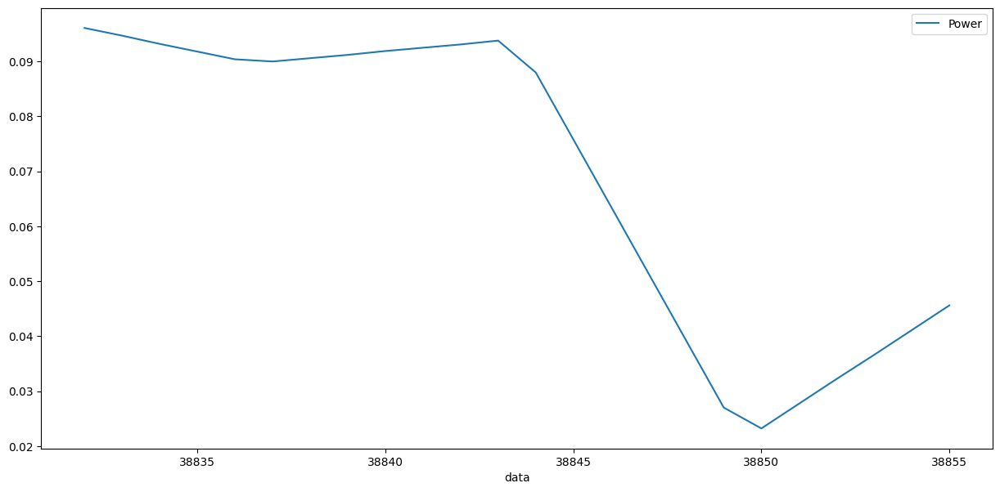

In [7]:
df_Loc_1[df_Loc_1['date'] == '2021-06-08'].plot(y = 'Power', kind = 'line', xlabel='data', figsize=(15,7))

In [8]:
#creating a new dataframe with averages of each day

value = []
for entry in df_Loc_1['date'].unique():
    x = df_Loc_1[df_Loc_1['date'] == entry].mean()
    value.append(x)

df_loc_1_Avg_per_day = pd.DataFrame(value)

#print(df_loc_1_Avg_per_day [df_loc_1_Avg_per_day ['Power'] == 0.0])

#df_loc_1_Avg_per_day.at[488, 'Power'] = 0.1

#df_loc_1_Avg_per_day.iloc[488]




In [9]:
#Check for values where power = 0 and get rid of value
for index in df_loc_1_Avg_per_day.index:
    if df_loc_1_Avg_per_day.loc[index, 'Power'] == 0:
        df_loc_1_Avg_per_day.drop(index, inplace=True)


In [10]:
df_decomposition = df_loc_1_Avg_per_day[['date', 'Power']].copy()
df_decomposition.set_index('date', inplace= True)
df_decomposition.index = pd.to_datetime(df_decomposition.index)

In [11]:
for value in df_decomposition['Power']:
    if np.any(value <=0):
        print (value)

print(df_decomposition[df_decomposition['Power'] == 0.0])

Empty DataFrame
Columns: [Power]
Index: []


In [12]:
###USING sm.tsa FOR DECOMPOSITION

#decomposition = sm.tsa.seasonal_decompose(df_decomposition, model = 'multiplicative', extrapolate_trend= 'freq')

#decomp = decomposition.plot()
#decomp.suptitle("Power Decomposition")

# changing the runtime configuration parameters to 
# have a desired plot of desired size, etc
#rcParams['figure.figsize'] = 15,15
#rcParams['axes.labelsize'] = 12
#rcParams['ytick.labelsize'] = 12
#rcParams['xtick.labelsize'] = 12

In [13]:
###USING PROPHET###
df = df_loc_1_Avg_per_day[['Time', 'Power']].copy()
df.rename(columns = {'Time': 'ds', 'Power':'y'}, inplace=True)
#df.dtypes

m = Prophet()
m.fit(df)


11:09:06 - cmdstanpy - INFO - Chain [1] start processing


11:09:07 - cmdstanpy - INFO - Chain [1] done processing


In [14]:
future = m.make_future_dataframe(periods=365)

In [16]:
forecast = m.predict(future)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
2184,2022-12-27 11:30:00,0.492555,0.220845,0.775734
2185,2022-12-28 11:30:00,0.503463,0.209873,0.789649
2186,2022-12-29 11:30:00,0.496396,0.216722,0.791046
2187,2022-12-30 11:30:00,0.491397,0.213710,0.779840
2188,2022-12-31 11:30:00,0.471176,0.171606,0.741309


C:\Users\heroa\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\prophet\plot.py:72: FutureWarning: The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result
  fcst_t = fcst['ds'].dt.to_pydatetime()
C:\Users\heroa\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\prophet\plot.py:73: FutureWarning: The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result
  ax.plot(m.history['ds'].dt.to_pydatetime(), m.history['y'], 'k.',


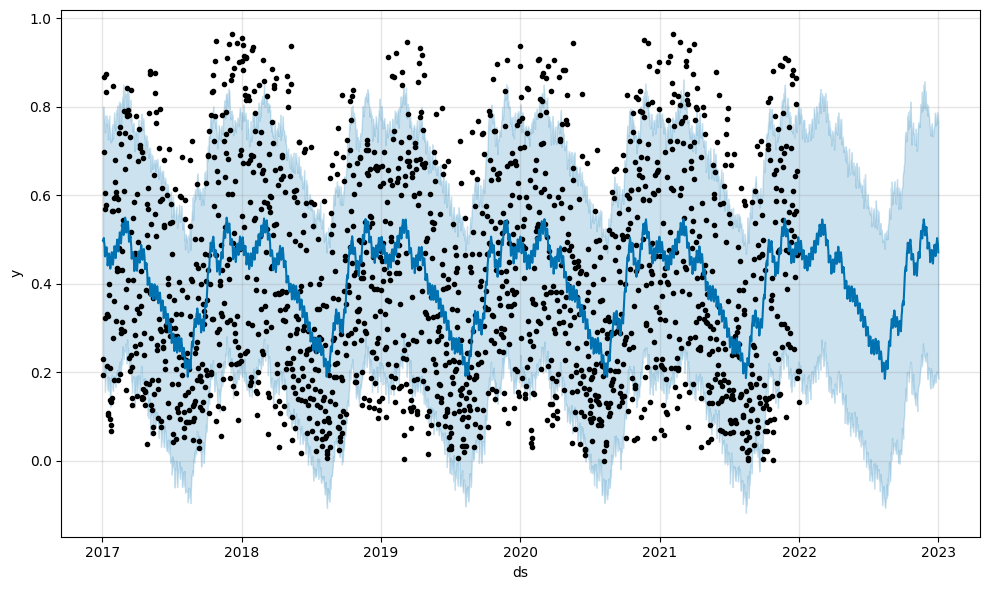

In [16]:
fig1 = m.plot(forecast)

C:\Users\heroa\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\prophet\plot.py:228: FutureWarning: The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result
  fcst_t = fcst['ds'].dt.to_pydatetime()
C:\Users\heroa\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\prophet\plot.py:351: FutureWarning: The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result
  df_y['ds'].dt.to_pydatetime(), seas[name], ls='-', c='#0072B2')
C:\Users\heroa\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\Lo

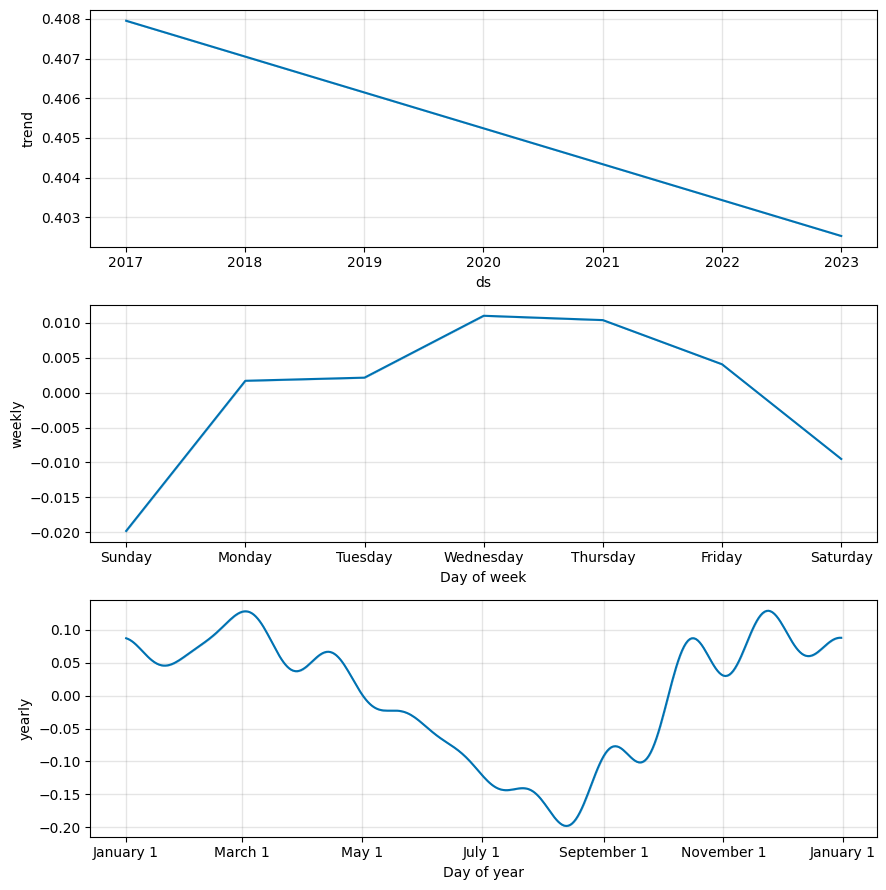

In [17]:
fig2 = m.plot_components(forecast)

In [18]:
plot_plotly(m, forecast)

In [20]:
plot_components_plotly(m, forecast)
